# Simple Image Super Resolution (SISR) using a GAN


**Author: Javier Orduña Rubio**



## Introduction

The complicated task of estimating a high-resolution image from its low-resolution matrix is ​​known as super-resolution (SR). This is a field of study that has received great attention in recent years within computer vision and has a multitude of applications.

Generally, MSE (Mean Squared Error) and PSNR (peak-signal-to-noise-ratio) metrics are used to measure the effectiveness of reconstructed images. However, these are limited to perceive high texture details and tend to excessively smooth the images, reducing their quality. In this notebook, we will deal with super resolution images by increasing the size of the pixels in each dimension by 4. That is, 16 per color.

SR problems depend to a large extent on the loss function to be minimized. Therefore, we establish two models:

* Model 1. We will use the pixel-to-pixel MSE for the generator and Binary Cross Entropy for the discriminator.

* Model 2. We will use pixel-to-pixel MSE for the generator together with an MSE from a feature space of the ResNet50 network. For the discriminator we will use Binary Cross Entropy.

In the corresponding sections we will detail more these architectures.

*NOTE: This notebook is executed so it contains certain lines of code that are not essential for the operation of the notebook in another environment.*

## Importación de librerías y datos

Importemos las librerías necesarias para ejecutar este notebook:

In [1]:
# diseñar red 
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout, \
 Conv2DTranspose, Conv2D, PReLU, BatchNormalization, ReLU, LeakyReLU, MaxPool2D, UpSampling2D
from tensorflow.keras.layers import BatchNormalization, Add, Layer
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.activations import sigmoid
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras import Model, regularizers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint


# representar imágenes
import cv2
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline

# otras librerías
import os
import time
import random
import glob
import numpy as np

In [4]:
# configure file to store files in Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/My Drive/DataSuperResolution


In [5]:
# directories creation
directorios_a_crear = ('./training_model2','./training_model1')

for dir in directorios_a_crear:
  if os.path.isdir(dir)!=True:
    os.mkdir(dir) 
  else:
    pass

The data we are going to use comes from a Kaggle competition. These are 100 images of all kinds of subjects stored in low resolution (LR) and high resolution (HR). The link is in the references of the work.

We are going to define a series of functions to load the data.

In [6]:
def load(path,shape):
    """
    This function reads an image that is in BGR format and converts it to RGB format,
    transforming it to the indicated size (shape)
    """
    img= cv2.imread(path)
    img= cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # BGR --> RGB
    img= cv2.resize(img, shape) # resize
    return img

def get_data(path):
    """
    This function reads all the images in a directory (path) and stores them in two vectors:
    * X stores the high resolution HR images
    * And stores the low resolution LR images (already transformed by the load function)
    The pixels are normalized between 0 and 1.
    """
    X=[]
    Y=[]
    for folder in glob.glob(path+ str('/*')): # glob.glob busca todas las carpetas de path+'/*'   
        if folder == os.path.join(path, 'HR'):
               for img in range(100):
                  img_path = os.path.join(folder, str(img)+'.png')
                  X.append(load(img_path, (384, 384)))
        elif folder == os.path.join(path, 'LR'):
              for img in range(100):
                  img_path = os.path.join(folder, str(img)+ '.png')
                  Y.append(load(img_path, (96,96)))

    X= np.array(X)
    Y= np.array(Y)
    return X/255.0, Y/255.0

We separate the data into training and test in a simple way. We choose the first 90 images for training and the other 10 for testing.

In [7]:
HR, LR = get_data('./data')
HR_train, LR_train = HR[:90], LR[:90]
HR_test, LR_test = HR[90:], LR[90:]


In [8]:
print(HR_train.shape)
print(HR_test.shape)
print(LR_train.shape)
print(LR_test.shape)

(90, 384, 384, 3)
(10, 384, 384, 3)
(90, 96, 96, 3)
(10, 96, 96, 3)


Let's show a random image in low and high resolution.

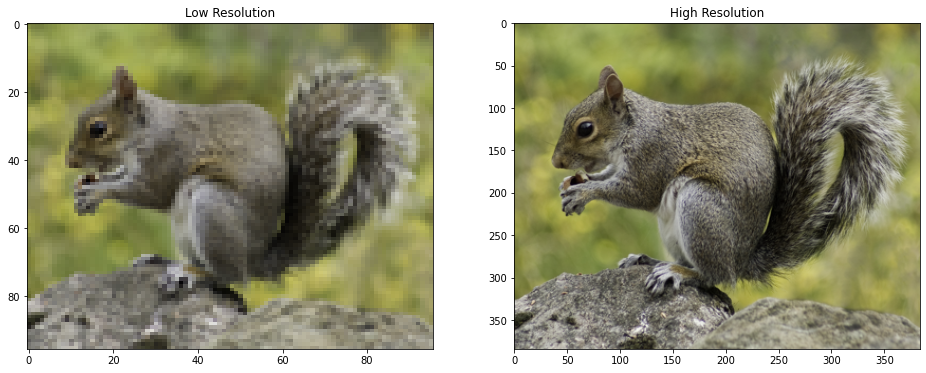

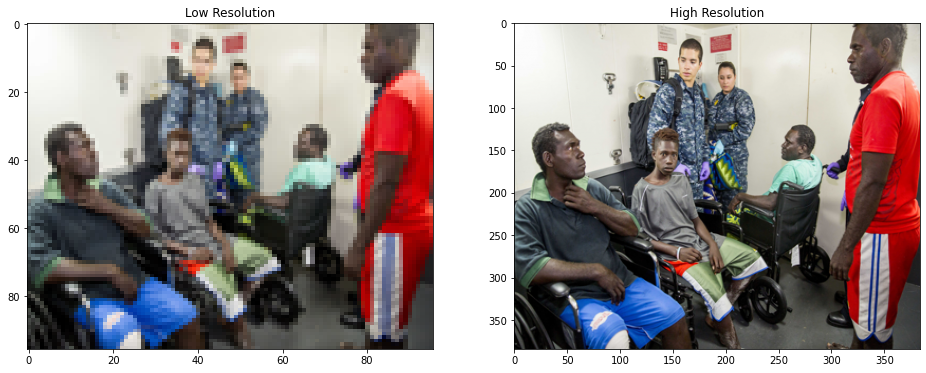

In [ ]:
save_ind = 9

f, ax= plt.subplots(1,2, figsize=(16, 6))
ax[0].imshow(LR_train[save_ind], aspect='auto')
ax[0].set_title("Low Resolution")
ax[1].imshow(HR_train[save_ind], aspect='auto')
ax[1].set_title("High Resolution")
plt.show()

save_ind = 12

f, ax= plt.subplots(1,2, figsize=(16, 6))
ax[0].imshow(LR_train[save_ind], aspect='auto')
ax[0].set_title("Low Resolution")
ax[1].imshow(HR_train[save_ind], aspect='auto')
ax[1].set_title("High Resolution")
plt.show()

## Models

### Loss function definition

We define a class for a layer of the network that we will use in our model. We define our model as `GAN`. This incorporates 2 training functions that give rise to the two models discussed in the introduction:

* `train` handles training using MSE and BinaryCrossEntropy

* `train_transfer` handles training using MSE, the feature space MSE contribution, and BinaryCrossEntropy

Why do we define a different loss function? Well, this one is intended to be more ambitious than the previous one, since it combines the pixel-to-pixel mean square error with a metric of a feature space of high-resolution images. The motivation for using this feature space is the search for a comparison method that is better than pixel by pixel and that manages to capture the image characteristics that give it realism, such as texture or smoothness.

The feature space of each image will be obtained through a known deep convolutional network. We have chosen ResNet50 because it offers a reduced execution time (4.5s per step) and a reduced number of parameters compared to other models while maintaining good performance. We will use the training weights from the `imagenet` dataset.

Regarding the metric that we will use to evaluate the vectors of the space of characteristics of the real image and the synthetic image of the generator, we are presented with a great variety of options. We will use the MSE although we could also have used the Euclidean distance.

The feature space will be given by layer number 6 passed to a dense layer of 5,000 parameters, which gives us 5,000 dimensions. Let's define a `transfer_learning_loss` function that calculates the MSE of such a feature space.

In [ ]:
resnet50 = tf.keras.applications.ResNet50(
    include_top=False, 
    weights='imagenet',
    input_tensor=None,
    input_shape= (384,384,3),
    pooling=None,
    classes=1000,
    classifier_activation='softmax'
)



feature_extractor = Model(inputs=resnet50.inputs, outputs= Dense(5000)(Flatten()(resnet50.layers[-5].output))) # 2048 dimensiones

def transfer_learning_loss(y_true, y_pred):

    assert y_true.shape == y_pred.shape

    features_loss = []

    if len(y_true.shape) == 4:

      for i in range(y_true.shape[0]):

        # feature extraction ---- transfer learning
        features_pred = feature_extractor( tf.reshape( y_pred[i,:,:,:], [1,384,384,3]) ) 
        features_true = feature_extractor( tf.reshape( y_true[i,:,:,:], [1,384,384,3]) ) 
        features_loss.append( tf.keras.metrics.mean_squared_error(features_true, features_pred) )

    return np.array(features_loss).mean()

94781440/94765736 [==============================] - 1s 0us/step


In [10]:
class SubpixelConv2D(Layer):
    """ Subpixel Conv2D Layer
    upsampling a layer from (h, w, c) to (h*r, w*r, c/(r*r)),
    where r is the scaling factor, default to 4
    # Arguments
    upsampling_factor: the scaling factor
    # Input shape
        Arbitrary. Use the keyword argument `input_shape`
        (tuple of integers, does not include the samples axis)
        when using this layer as the first layer in a model.
    # Output shape
        the second and the third dimension increased by a factor of
        `upsampling_factor`; the last layer decreased by a factor of
        `upsampling_factor^2`.
    # References
        Real-Time Single Image and Video Super-Resolution Using an Efficient
        Sub-Pixel Convolutional Neural Network Shi et Al. https://arxiv.org/abs/1609.05158
    """

    def __init__(self, upsampling_factor=2, **kwargs):
        super(SubpixelConv2D, self).__init__(**kwargs)
        self.upsampling_factor = upsampling_factor

    def build(self, input_shape):
        last_dim = input_shape[-1]
        factor = self.upsampling_factor * self.upsampling_factor
        if last_dim % (factor) != 0:
            raise ValueError('Channel ' + str(last_dim) + ' should be of '
                             'integer times of upsampling_factor^2: ' +
                             str(factor) + '.')

    def call(self, inputs, **kwargs):
        return tf.nn.depth_to_space( inputs, self.upsampling_factor )

    def get_config(self):
        config = { 'upsampling_factor': self.upsampling_factor, }
        base_config = super(SubpixelConv2D, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))

    def compute_output_shape(self, input_shape):
        factor = self.upsampling_factor * self.upsampling_factor
        input_shape_1 = None
        if input_shape[1] is not None:
            input_shape_1 = input_shape[1] * self.upsampling_factor
        input_shape_2 = None
        if input_shape[2] is not None:
            input_shape_2 = input_shape[2] * self.upsampling_factor
        dims = [ input_shape[0],
                 input_shape_1,
                 input_shape_2,
                 int(input_shape[3]/factor)
               ]
        return tuple( dims )

### GAN class
Now we define the class `GAN`. 

* Adam Compilator different learning rates depending on the case we are: if we use the model 1 this has the value 0.0001 and if we are using the model 2 this has two learning rates depending of the moment of the training where we are.
* Training updating the weights with minibatches of size 5 using the method train_on_batch.

In [13]:
class GAN(object):
    """ Generative Adversarial Network class """
    def __init__(self, width_D=384, height_D=384, width_G = 96, height_G = 96,  channels=3):  
      # Inicializo a las dimensiones de las imágenes de alta resolución

        self.width_D = width_D
        self.height_D = height_D
        self.width_G = width_G
        self.height_G = height_G
        self.channels = channels

        self.shape_D = (self.width_D, self.height_D, self.channels)
        self.shape_G = (self.width_G, self.height_G, self.channels)

        self.optimizer = Adam(learning_rate=0.0002)

        self.G = self.__generator()
        self.G.compile(loss='mse', optimizer=self.optimizer)

        self.D = self.__discriminator()
        self.D.compile(loss="binary_crossentropy", optimizer=self.optimizer, metrics=['accuracy'])

        self.stacked_generator_discriminator = self.__stacked_generator_discriminator()

        
        self.stacked_generator_discriminator.compile(loss= "binary_crossentropy", optimizer=self.optimizer)


    def __generator(self):
        """ Declare generator """

        input = Input(shape = self.shape_G)
        x1 = Conv2D(32,9, strides = 1, padding = 'same' )(input)
        x1 = PReLU()(x1)
        b1 = list()
        b1.append(x1)

        for i in range(2): #cambio 5 por 1
          x1 = Conv2D(32,3, strides = 1, padding = 'same' )(x1)
          x1 = BatchNormalization()(x1)
          x1 = PReLU()(x1)
          x1 = Conv2D(32,3, strides = 1, padding = 'same' )(x1)
          x1 = BatchNormalization()(x1)
          x1 = Add()([x1,b1[i]])
          b1.append(x1)

        x1 = Conv2D(32,3, strides = 1, padding = 'same' )(x1)
        x1 = BatchNormalization()(x1)
        x1 = Add()([b1[0], x1])

        for i in range(2): #2 por 1
          x1 = Conv2D(64,3, strides = 1, padding = 'same' )(x1)
          x1 = SubpixelConv2D(upsampling_factor=2)(x1)
          x1 = PReLU()(x1)
        
        output = Conv2D(3, 9, strides = 1, padding = 'same', activation = 'sigmoid')(x1)

        model = Model(input, output)

        return model

    def __discriminator(self):
        """ Declare discriminator """

        input = Input(shape = self.shape_D)
        x = Conv2D(32, 3, strides = 1, padding = 'same' )(input)
        x = LeakyReLU(alpha = 0.2)(x)

        x  = Conv2D(32, 3, strides = 2, padding = 'same' )(x)
        x = BatchNormalization()(x)
        x = LeakyReLU(alpha = 0.2)(x)

        x  = Conv2D(64, 3, strides = 1, padding = 'same' )(x)
        x = BatchNormalization()(x)
        x = LeakyReLU(alpha = 0.2)(x)

        x  = Conv2D(64, 3, strides = 2, padding = 'same' )(x)
        x = BatchNormalization()(x)
        x = LeakyReLU(alpha = 0.2)(x)

        x  = Conv2D(128, 3, strides = 1, padding = 'same' )(x)
        x = BatchNormalization()(x)
        x = LeakyReLU(alpha = 0.2)(x)

        x  = Conv2D(128, 3, strides = 2, padding = 'same' )(x)
        x = BatchNormalization()(x)
        x = LeakyReLU(alpha = 0.2)(x)

        x  = Conv2D(256, 3, strides = 1, padding = 'same' )(x)
        x = BatchNormalization()(x)
        x = LeakyReLU(alpha = 0.2)(x)

        x  = Conv2D(256, 3, strides = 2, padding = 'same' )(x)
        x = BatchNormalization()(x)
        x = LeakyReLU(alpha = 0.2)(x)

        x = Dense(512)(x)
        x = LeakyReLU(alpha = 0.2)(x)
        x = Flatten()(x)
        output = Dense(1, activation = 'sigmoid')(x)
        

        model = Model(input, output)

        return model

    def __stacked_generator_discriminator(self):

        self.D.trainable = False

        model = Sequential()
        model.add(self.G)
        model.add(self.D)

        return model


    ################### ------- Usual training ------------- ###########

    def train(self, X_train_HR= HR_train, X_train_LR = LR_train, epochs=200, batch = 5):

        DD_loss = np.zeros((epochs,))
        GG_loss = np.zeros((epochs,))
        lr = 0.0001

        for cnt in range(epochs):
            # generate a random index in the range of the number of images, ensuring that the batch fits the gap 
            random_index = np.random.randint(0, len(X_train_HR) - np.int64(batch))
            
            # select HR and LR images with the previously generated random index
            X_HR = X_train_HR[random_index: random_index + np.int64(batch)]
            X_LR = X_train_LR[random_index: random_index + np.int64(batch)]

            # predict HR images using the generator
            syntetic_images = self.G.predict(X_LR)

            #Train discriminator: concat the syntetic images with the real ones, giving these images 1 and 0 labels respectively.
            x_combined_batch = np.concatenate((X_HR, syntetic_images))
            y_combined_batch = np.concatenate((np.ones((np.int64(batch), 1)), np.zeros((np.int64(batch), 1))))

            d_loss = self.D.train_on_batch(x_combined_batch, y_combined_batch)

            # store the loss in each iteration 
            DD_loss[cnt] = d_loss[0]

            # we use the tf.GradientTape to update the weights
            with tf.GradientTape(persistent=False) as tape:
              # as before, we generate syntetic images with the generator
              syntetic_images = self.G(X_LR)

              # pass those syntetic images to the discriminator in order to obtain a prediction of the label
              etiq_fake = self.D(syntetic_images)

              # loss function contributions: mse for the generator (pixel by pixel) and binary cross entropy for the discriminator
              gan_loss= 2e-3*tf.keras.losses.BinaryCrossentropy()(etiq_fake , tf.ones_like(etiq_fake))
              mse_loss=  2e-1* tf.reduce_mean(tf.reduce_mean(tf.math.squared_difference(syntetic_images, X_HR), axis=-1))
      
              # loss function: addition of both loss functions
              g_loss = mse_loss + gan_loss

            # weights update
            grad = tape.gradient(g_loss, self.G.trainable_weights)
            Adam(learning_rate= lr).apply_gradients(zip(grad, self.G.trainable_weights))
            GG_loss[cnt] = g_loss

            # For a better understanding, what we have done here is the following process:
            # - Inside a tf.GradientTape context, we make a forward pass through the model to obtain the prediction of the generator and the discriminator
            # - We then compute the both loss values and summing it in a variable called g_loss. 
            # - We then use tape.gradient to compute gradients of the loss with respect to the trainable variables in the model, which are stored in the grad variable.
            # - Finally, we use the model's optimizer to update the weights of the model using the computed gradients.


            print('epoch: %d, [Discriminator :: d_loss: %f], [ Generator :: loss: %f]' % (cnt, d_loss[0], g_loss))

            # Save the models and its weights every 300 iterations:
            if cnt % 300 == 0:
                self.G.save('./drive/MyDrive/DataSuperResolution/training_final_red/modelG'+ str(cnt))
                
                self.D.save('./drive/MyDrive/DataSuperResolution/training_final_red/modelD' + str(cnt))
                pred = self.G.predict(LR_train)

                plt.figure()
                f, ax= plt.subplots(1,2, figsize=(16, 6))
                ax[0].imshow(pred[8], aspect='auto')
                ax[1].imshow(HR_train[8], aspect='auto')
                plt.show()

        return  DD_loss, GG_loss


    ################### ------- Transfer learning training ------------- ###########

    def train_transfer(self, X_train_HR= HR_train, X_train_LR = LR_train, path='train_modelo2', 
                       epochs=200, batch = 5, save_interval=300):

        DD_loss = np.zeros((epochs,))
        GG_loss = np.zeros((epochs,))
        lr_1 = 0.00012
        lr_2 = 0.0001 

        for cnt in range(epochs):
            # same process as before in the usual function
            random_index = np.random.randint(0, len(X_train_HR) - np.int64(batch))
            
            X_HR = X_train_HR[random_index: random_index + np.int64(batch)]
            X_LR = X_train_LR[random_index: random_index + np.int64(batch)]
            syntetic_images = self.G.predict(X_LR)

            #Train discriminator
            x_combined_batch = np.concatenate((X_HR, syntetic_images))
            y_combined_batch = np.concatenate((np.ones((np.int64(batch), 1)), np.zeros((np.int64(batch), 1))))

            d_loss = self.D.train_on_batch(x_combined_batch, y_combined_batch)
            DD_loss[cnt] = d_loss[0]

            # Train generator. We divide the training in two phases: one that come first where the learning rate is high and another phase
            # with a smaller learning rate
            if cnt < epochs/2:
              with tf.GradientTape(persistent=False) as tape:
                syntetic_images = self.G(X_LR)
                etiq_fake = self.D(syntetic_images)

                # loss functions contributions defined as before
                gan_loss= 2e-3*tf.keras.losses.BinaryCrossentropy()(etiq_fake , tf.ones_like(etiq_fake))
                mse_loss=  2e-1* tf.reduce_mean(tf.reduce_mean(tf.math.squared_difference(syntetic_images, X_HR), axis=-1))
                
                # Another loss function using the transfer learning loss (MSE in feature space of Resnet50)
                tl_loss = 2 * transfer_learning_loss(X_HR, syntetic_images)

                # final loss function
                g_loss = mse_loss + gan_loss + tl_loss

              grad = tape.gradient(g_loss, self.G.trainable_weights)
              Adam(learning_rate= lr_1).apply_gradients(zip(grad, self.G.trainable_weights))
              GG_loss[cnt] = g_loss

            else:
                with tf.GradientTape(persistent=False) as tape:
                  syntetic_images = self.G(X_LR)
                  etiq_fake = self.D(syntetic_images)
                  
                  # loss functions contributions defined as before
                gan_loss= 2e-3*tf.keras.losses.BinaryCrossentropy()(etiq_fake , tf.ones_like(etiq_fake))
                mse_loss=  2e-1* tf.reduce_mean(tf.reduce_mean(tf.math.squared_difference(syntetic_images, X_HR), axis=-1))
                
                # Another loss function using the transfer learning loss (MSE in feature space of Resnet50)
                tl_loss = 2 * transfer_learning_loss(X_HR, syntetic_images)

                # final loss function
                g_loss = mse_loss + gan_loss + tl_loss

              grad = tape.gradient(g_loss, self.G.trainable_weights)
              Adam(learning_rate= lr_2).apply_gradients(zip(grad, self.G.trainable_weights))
              GG_loss[cnt] = g_loss              


            print('epoch: %d, [Discriminator :: d_loss: %f], [ Generator :: loss: %f]' % (cnt, d_loss[0], g_loss))

            if cnt % save_interval == 0:
                self.G.save('./' + path + '/modelG'+ str(cnt)+'.h5')
                self.D.save('./' + path + '/modelD' + str(cnt)+'.h5')
                pred = self.G.predict(LR_train)

                plt.figure()
                f, ax= plt.subplots(1,2, figsize=(16, 6))
                ax[0].imshow(pred[8], aspect='auto')
                ax[1].imshow(HR_train[8], aspect='auto')
                plt.show()

        return  DD_loss, GG_loss



### Network architechture


#### Generator
Let's see the generator architechture:


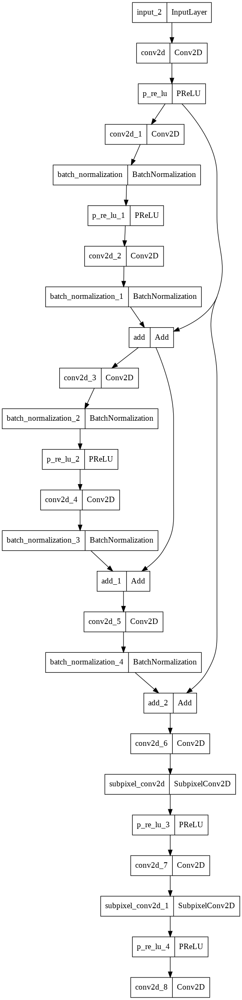

In [ ]:
tf.keras.utils.plot_model(GAN().G)

In [ ]:
GAN().G.summary()

Model: "model_13"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_14 (InputLayer)          [(None, 96, 96, 3)]  0           []                               
                                                                                                  
 conv2d_102 (Conv2D)            (None, 96, 96, 32)   7808        ['input_14[0][0]']               
                                                                                                  
 p_re_lu_30 (PReLU)             (None, 96, 96, 32)   294912      ['conv2d_102[0][0]']             
                                                                                                  
 conv2d_103 (Conv2D)            (None, 96, 96, 32)   9248        ['p_re_lu_30[0][0]']             
                                                                                           


#### Discriminator

Now let's see the architecture of the discriminator.

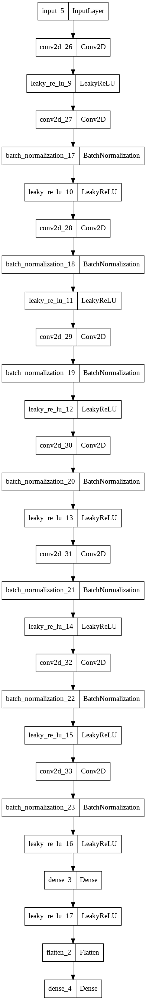

In [ ]:
tf.keras.utils.plot_model(GAN().D)

In [ ]:
GAN().D.summary()

Model: "model_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_17 (InputLayer)       [(None, 384, 384, 3)]     0         
                                                                 
 conv2d_128 (Conv2D)         (None, 384, 384, 32)      896       
                                                                 
 leaky_re_lu_63 (LeakyReLU)  (None, 384, 384, 32)      0         
                                                                 
 conv2d_129 (Conv2D)         (None, 192, 192, 32)      9248      
                                                                 
 batch_normalization_89 (Bat  (None, 192, 192, 32)     128       
 chNormalization)                                                
                                                                 
 leaky_re_lu_64 (LeakyReLU)  (None, 192, 192, 32)      0         
                                                          

#### GAN

Now let's see the full GAN'S architecture.

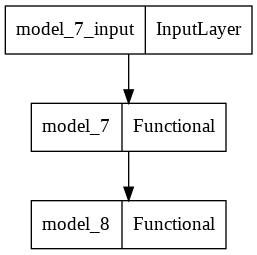

In [ ]:
tf.keras.utils.plot_model(GAN().stacked_generator_discriminator)

In [ ]:
GAN().stacked_generator_discriminator.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 model_9 (Functional)        (None, 384, 384, 3)       3920211   
                                                                 
 model_10 (Functional)       (None, 1)                 1602465   
                                                                 
Total params: 5,522,676
Trainable params: 3,919,891
Non-trainable params: 1,602,785
_________________________________________________________________


## Modelo 1. Clasical loss function (no feature space component)

### Training

We initialize the training with 200 epochs of the generator only to initialize the weights and speed up the convergence. Subsequently, we train the complete model.

In [ ]:
# gan = GAN()
# gan.G.fit(x = LR_train, y = HR_train, epochs = 200, batch_size = 5) 

In [ ]:
# DD_loss, GG_loss = gan.train(epochs = 4501, path="training_model1")

In [ ]:
# plt.plot(DD_loss, label="discriminador")
# plt.plot(GG_loss, label="generador")
# plt.yscale('log')
# plt.legend()

Load the models stored during training.

In [18]:
def cargar_modelos(iter=range(0,4201,300), 
                   entrenamiento_a_cargar='training', 
                   saving_format='.h5', form='model'):
  gan = GAN()
    
  modelsG = list()
  modelsD = list()

  for i in iter:

    if form=='weights':

      gan.G.load_weights('./'+entrenamiento_a_cargar+'/modelG' + str(i)+saving_format)
      modelsG.append(gan.G) 
      gan.D.load_weights('./'+entrenamiento_a_cargar+'/modelD' + str(i)+saving_format)
      modelsD.append(gan.D)

    elif form=='model':

      x = tf.keras.models.load_model('./'+entrenamiento_a_cargar+'/modelG' + str(i))
      modelsG.append(x)
      y = tf.keras.models.load_model('./'+entrenamiento_a_cargar+'/modelD' + str(i))

  
  return modelsG, modelsD

modelsG, modelsD = cargar_modelos(entrenamiento_a_cargar='./training_model1_Javi', form='model')

Let's perform the prediction on the `LR_train` training samples for each of the models we previously stored in `modelsG`. We store them in a dictionary keyed to the number of iterations of the model.


In [19]:
def predecir_dict(iter=range(0,4201,300), modelsG=modelsG, LR_train=LR_train):

  predicciones = {str(iter[i]):modelsG[i].predict(LR_train) for i in range(len(iter))}

  return predicciones 

predicciones_train_model1 = predecir_dict(modelsG=modelsG, LR_train=LR_train)

In [ ]:
predicciones_train_model1.keys()

dict_keys(['0', '300', '600', '900', '1200', '1500', '1800', '2100', '2400', '2700', '3000', '3300', '3600', '3900', '4200'])

We are going to show the results of the generator (the HR images generated by it) for one concrete image in the different moments of the training.

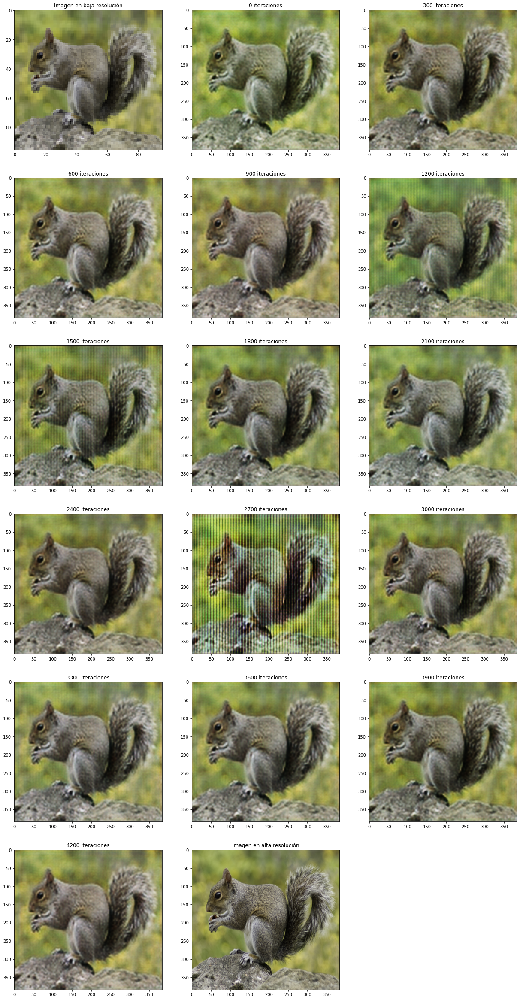

In [20]:
def plot_results(predicciones, img=9, HR=HR_train, LR=LR_train):

  # estudio para ver cuantas filas dibujar
  m = len(predicciones)
  x = m % 3
  nrows = m/3 if x==0 else int(m/3)+1
  nrows += 1
  ncols = 3

  # indices 
  keys = list(predicciones.keys())

  # plot
  fig = plt.figure(figsize=(7*ncols, 7 *nrows))
  # mostramos la imagen original en baja resolución
  ax = fig.add_subplot( nrows, ncols, 1 )
  ax.set_title('Imagen en baja resolución')
  ax.imshow(LR[img], aspect='auto')
  # representamos la imagen de alta resolución generada por cada modelo
  for i in range(2,m+2):
    ax = fig.add_subplot(nrows,ncols, i)
    ax.imshow(predicciones[ keys[i-2] ][img], aspect='auto')
    ax.set_title(keys[i-2]+' iteraciones')

  ax = fig.add_subplot(nrows,ncols,i+1)
  ax.imshow(HR[img], aspect='auto')
  ax.set_title('Imagen en alta resolución')

plot_results(predicciones_train_model1, img=9)

### Test

Let's check the test results, making predictions with each one of the generators stored in the folder `modelsG`, which represents the generator in each moment of the training. 

In [21]:
predicciones_test_model1 = predecir_dict(iter=range(0,4201,300),
                             modelsG=modelsG, 
                             LR_train=LR_test)

We will show the result for one concrete test_image:

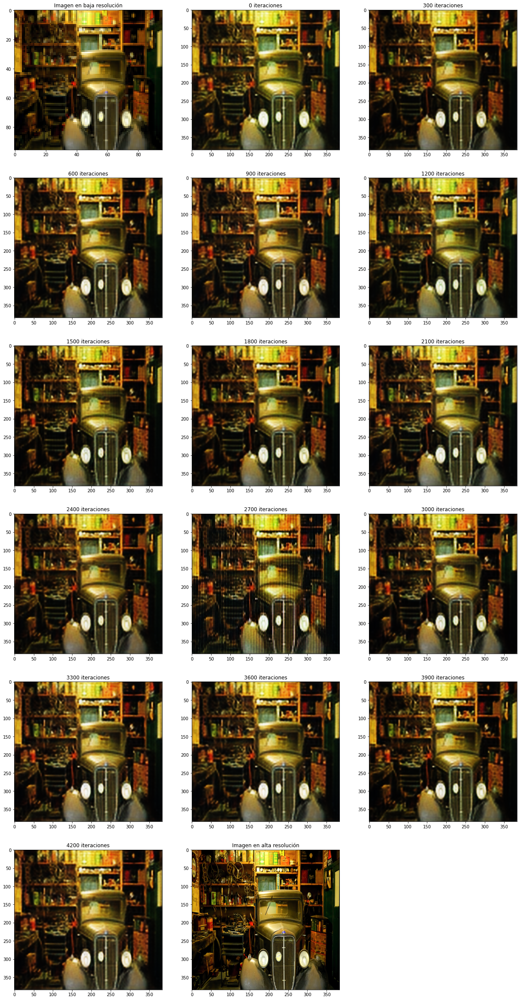

In [22]:
plot_results(predicciones_test_model1, img=9, HR=HR_test, LR=LR_test)

We observe that the results obtained are good, since they improve the resolution of the original image, but they are far from the high definition image. It is also true that with more iterations (we need more resources for this) the result would gradually improve.

## Modelo 2. Loss function using transfer learning

### Training

As before, we initialise the training.

In [14]:
modelo2 = GAN()
modelo2.G.fit(x = LR_train, y = HR_train, epochs = 200, batch_size = 5) #200

Epoch 1/200
18/18 [==============================] - 7s 330ms/step - loss: 0.0599
Epoch 2/200
18/18 [==============================] - 6s 330ms/step - loss: 0.0306
Epoch 3/200
18/18 [==============================] - 6s 330ms/step - loss: 0.0264
Epoch 4/200
18/18 [==============================] - 6s 329ms/step - loss: 0.0236
Epoch 5/200
18/18 [==============================] - 6s 331ms/step - loss: 0.0224
Epoch 6/200
18/18 [==============================] - 6s 332ms/step - loss: 0.0210
Epoch 7/200
18/18 [==============================] - 6s 331ms/step - loss: 0.0173
Epoch 8/200
18/18 [==============================] - 6s 331ms/step - loss: 0.0187
Epoch 9/200
18/18 [==============================] - 6s 331ms/step - loss: 0.0178
Epoch 10/200
18/18 [==============================] - 6s 331ms/step - loss: 0.0178
Epoch 11/200
18/18 [==============================] - 6s 331ms/step - loss: 0.0163
Epoch 12/200
18/18 [==============================] - 6s 331ms/step - loss: 0.0150
Epoch 13/200


epoch: 0, [Discriminator :: d_loss: 0.700059], [ Generator :: loss: 0.032447]


<Figure size 432x288 with 0 Axes>

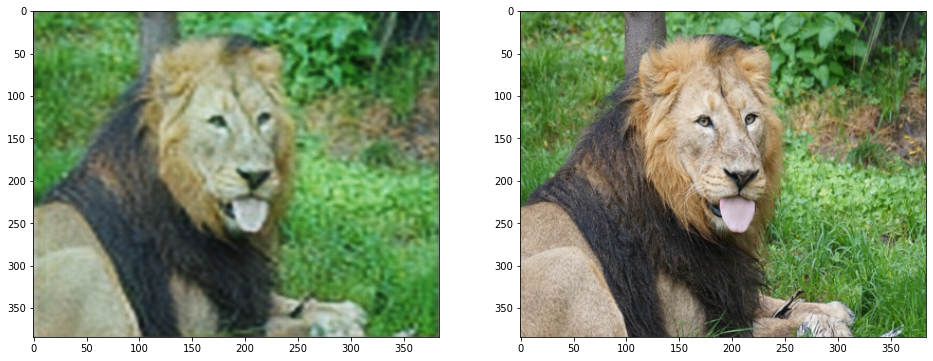

epoch: 1, [Discriminator :: d_loss: 5.859422], [ Generator :: loss: 0.031704]
epoch: 2, [Discriminator :: d_loss: 1.531330], [ Generator :: loss: 0.030923]
epoch: 3, [Discriminator :: d_loss: 10.851189], [ Generator :: loss: 0.030447]
epoch: 4, [Discriminator :: d_loss: 6.867612], [ Generator :: loss: 0.019353]
epoch: 5, [Discriminator :: d_loss: 5.578480], [ Generator :: loss: 0.028740]
epoch: 6, [Discriminator :: d_loss: 2.782569], [ Generator :: loss: 0.036967]
epoch: 7, [Discriminator :: d_loss: 3.201189], [ Generator :: loss: 0.036186]
epoch: 8, [Discriminator :: d_loss: 1.644100], [ Generator :: loss: 0.025608]
epoch: 9, [Discriminator :: d_loss: 1.490687], [ Generator :: loss: 0.036760]
epoch: 10, [Discriminator :: d_loss: 0.499471], [ Generator :: loss: 0.039259]
epoch: 11, [Discriminator :: d_loss: 2.507982], [ Generator :: loss: 0.032937]
epoch: 12, [Discriminator :: d_loss: 0.216255], [ Generator :: loss: 0.111100]
epoch: 13, [Discriminator :: d_loss: 1.548956], [ Generator 

<Figure size 432x288 with 0 Axes>

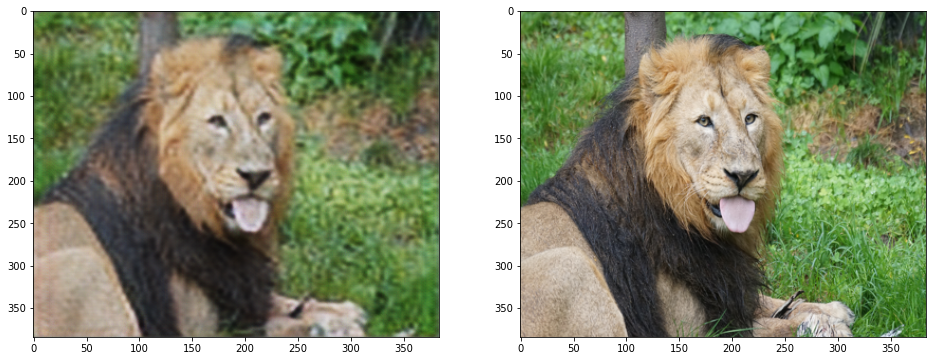

epoch: 301, [Discriminator :: d_loss: 0.000796], [ Generator :: loss: 0.038803]
epoch: 302, [Discriminator :: d_loss: 0.002445], [ Generator :: loss: 0.039683]
epoch: 303, [Discriminator :: d_loss: 0.001726], [ Generator :: loss: 0.048883]
epoch: 304, [Discriminator :: d_loss: 0.000473], [ Generator :: loss: 0.116605]
epoch: 305, [Discriminator :: d_loss: 0.000228], [ Generator :: loss: 0.045142]
epoch: 306, [Discriminator :: d_loss: 0.001723], [ Generator :: loss: 0.045379]
epoch: 307, [Discriminator :: d_loss: 0.002899], [ Generator :: loss: 0.042304]
epoch: 308, [Discriminator :: d_loss: 0.001154], [ Generator :: loss: 0.044833]
epoch: 309, [Discriminator :: d_loss: 0.000957], [ Generator :: loss: 0.038463]
epoch: 310, [Discriminator :: d_loss: 0.001868], [ Generator :: loss: 0.038940]
epoch: 311, [Discriminator :: d_loss: 0.003206], [ Generator :: loss: 0.062424]
epoch: 312, [Discriminator :: d_loss: 0.000285], [ Generator :: loss: 0.047777]
epoch: 313, [Discriminator :: d_loss: 0.

<Figure size 432x288 with 0 Axes>

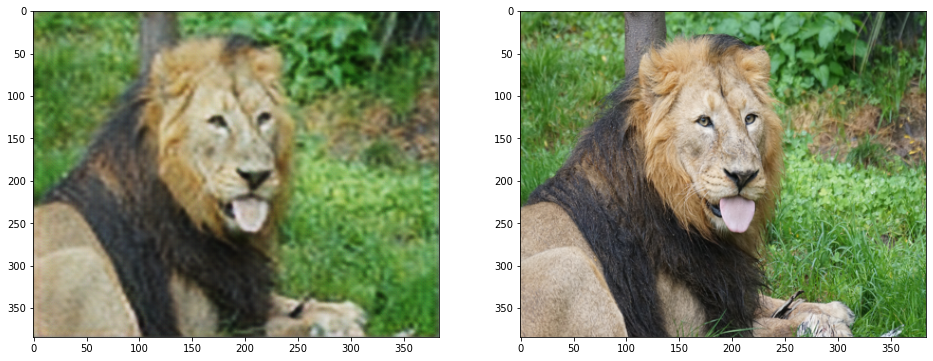

epoch: 601, [Discriminator :: d_loss: 0.000443], [ Generator :: loss: 0.041502]
epoch: 602, [Discriminator :: d_loss: 0.000044], [ Generator :: loss: 0.049055]
epoch: 603, [Discriminator :: d_loss: 0.001024], [ Generator :: loss: 0.037224]
epoch: 604, [Discriminator :: d_loss: 0.000132], [ Generator :: loss: 0.047777]
epoch: 605, [Discriminator :: d_loss: 0.000645], [ Generator :: loss: 0.045812]
epoch: 606, [Discriminator :: d_loss: 0.002119], [ Generator :: loss: 0.039509]
epoch: 607, [Discriminator :: d_loss: 0.001511], [ Generator :: loss: 0.042037]
epoch: 608, [Discriminator :: d_loss: 0.000961], [ Generator :: loss: 0.047214]
epoch: 609, [Discriminator :: d_loss: 0.000852], [ Generator :: loss: 0.038826]
epoch: 610, [Discriminator :: d_loss: 0.001863], [ Generator :: loss: 0.112467]
epoch: 611, [Discriminator :: d_loss: 0.000092], [ Generator :: loss: 0.119901]
epoch: 612, [Discriminator :: d_loss: 0.000364], [ Generator :: loss: 0.048077]
epoch: 613, [Discriminator :: d_loss: 0.

<Figure size 432x288 with 0 Axes>

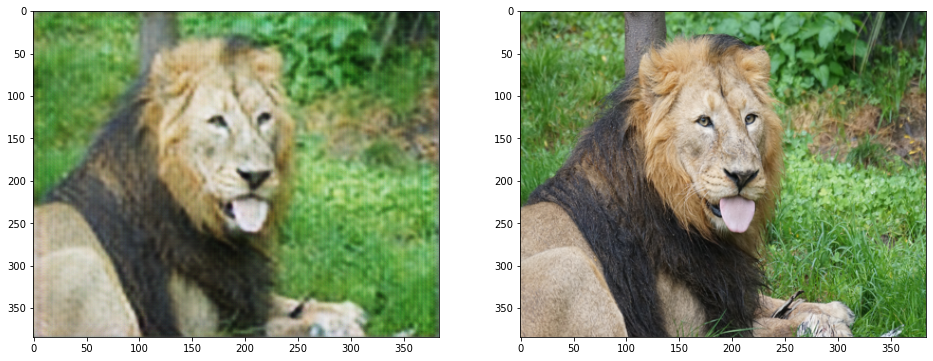

epoch: 901, [Discriminator :: d_loss: 0.109899], [ Generator :: loss: 0.008396]
epoch: 902, [Discriminator :: d_loss: 0.051982], [ Generator :: loss: 0.015797]
epoch: 903, [Discriminator :: d_loss: 0.036520], [ Generator :: loss: 0.007101]
epoch: 904, [Discriminator :: d_loss: 0.048606], [ Generator :: loss: 0.017677]
epoch: 905, [Discriminator :: d_loss: 0.007875], [ Generator :: loss: 0.003814]
epoch: 906, [Discriminator :: d_loss: 0.030656], [ Generator :: loss: 0.009767]
epoch: 907, [Discriminator :: d_loss: 0.028498], [ Generator :: loss: 0.008854]
epoch: 908, [Discriminator :: d_loss: 0.004327], [ Generator :: loss: 0.020517]
epoch: 909, [Discriminator :: d_loss: 0.073929], [ Generator :: loss: 0.009101]
epoch: 910, [Discriminator :: d_loss: 0.032746], [ Generator :: loss: 0.015272]
epoch: 911, [Discriminator :: d_loss: 0.000329], [ Generator :: loss: 0.083441]
epoch: 912, [Discriminator :: d_loss: 0.004793], [ Generator :: loss: 0.015977]
epoch: 913, [Discriminator :: d_loss: 0.

<Figure size 432x288 with 0 Axes>

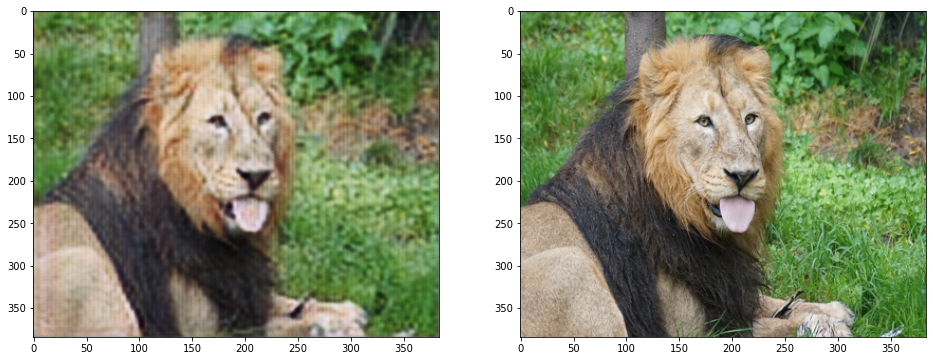

epoch: 1201, [Discriminator :: d_loss: 0.022731], [ Generator :: loss: 0.060267]
epoch: 1202, [Discriminator :: d_loss: 0.911043], [ Generator :: loss: 0.037674]
epoch: 1203, [Discriminator :: d_loss: 2.654574], [ Generator :: loss: 0.032642]
epoch: 1204, [Discriminator :: d_loss: 8.036777], [ Generator :: loss: 0.013557]
epoch: 1205, [Discriminator :: d_loss: 4.693130], [ Generator :: loss: 0.016049]
epoch: 1206, [Discriminator :: d_loss: 2.538945], [ Generator :: loss: 0.041186]
epoch: 1207, [Discriminator :: d_loss: 0.680081], [ Generator :: loss: 0.035214]
epoch: 1208, [Discriminator :: d_loss: 0.199421], [ Generator :: loss: 0.050540]
epoch: 1209, [Discriminator :: d_loss: 3.103048], [ Generator :: loss: 0.011395]
epoch: 1210, [Discriminator :: d_loss: 1.493273], [ Generator :: loss: 0.008726]
epoch: 1211, [Discriminator :: d_loss: 3.236291], [ Generator :: loss: 0.016913]
epoch: 1212, [Discriminator :: d_loss: 2.947966], [ Generator :: loss: 0.010532]
epoch: 1213, [Discriminator 

<Figure size 432x288 with 0 Axes>

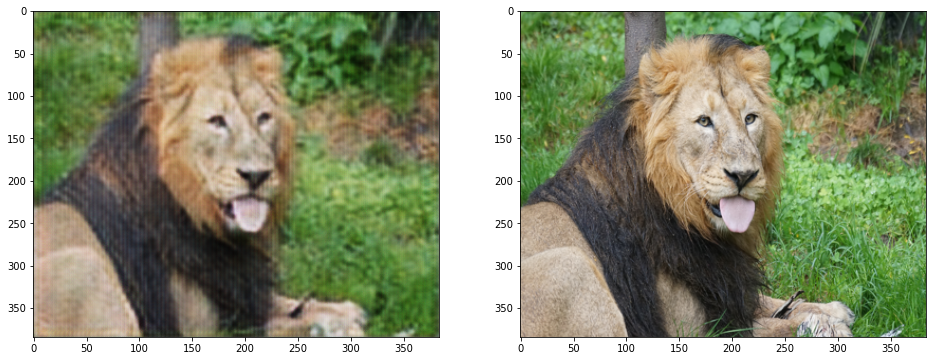

epoch: 1501, [Discriminator :: d_loss: 0.000026], [ Generator :: loss: 0.040615]
epoch: 1502, [Discriminator :: d_loss: 0.000001], [ Generator :: loss: 0.042024]
epoch: 1503, [Discriminator :: d_loss: 0.000011], [ Generator :: loss: 0.046695]
epoch: 1504, [Discriminator :: d_loss: 0.051965], [ Generator :: loss: 0.036170]
epoch: 1505, [Discriminator :: d_loss: 0.000151], [ Generator :: loss: 0.038746]
epoch: 1506, [Discriminator :: d_loss: 0.479926], [ Generator :: loss: 0.026629]
epoch: 1507, [Discriminator :: d_loss: 0.812895], [ Generator :: loss: 0.026400]
epoch: 1508, [Discriminator :: d_loss: 1.963076], [ Generator :: loss: 0.093719]
epoch: 1509, [Discriminator :: d_loss: 3.855036], [ Generator :: loss: 0.015523]
epoch: 1510, [Discriminator :: d_loss: 0.021660], [ Generator :: loss: 0.021363]
epoch: 1511, [Discriminator :: d_loss: 0.219291], [ Generator :: loss: 0.018975]
epoch: 1512, [Discriminator :: d_loss: 0.061165], [ Generator :: loss: 0.020476]
epoch: 1513, [Discriminator 

<Figure size 432x288 with 0 Axes>

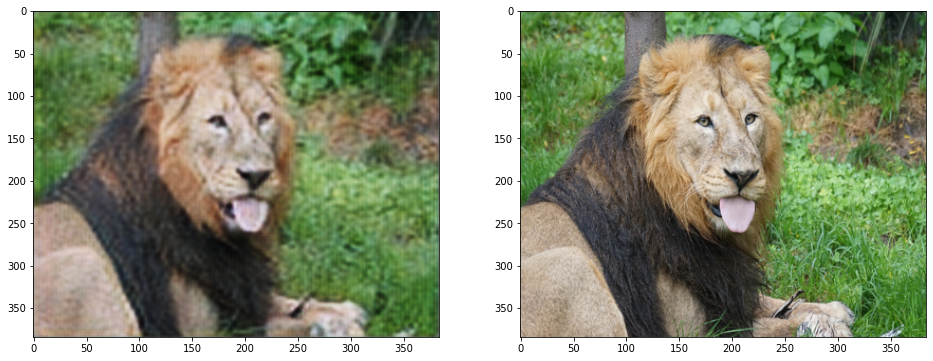

epoch: 1801, [Discriminator :: d_loss: 0.002650], [ Generator :: loss: 0.046241]
epoch: 1802, [Discriminator :: d_loss: 0.001621], [ Generator :: loss: 0.038225]
epoch: 1803, [Discriminator :: d_loss: 0.002016], [ Generator :: loss: 0.054802]
epoch: 1804, [Discriminator :: d_loss: 0.000521], [ Generator :: loss: 0.040083]
epoch: 1805, [Discriminator :: d_loss: 0.001481], [ Generator :: loss: 0.042014]
epoch: 1806, [Discriminator :: d_loss: 0.000813], [ Generator :: loss: 0.069135]
epoch: 1807, [Discriminator :: d_loss: 0.012633], [ Generator :: loss: 0.118709]
epoch: 1808, [Discriminator :: d_loss: 0.002230], [ Generator :: loss: 0.040059]
epoch: 1809, [Discriminator :: d_loss: 0.000811], [ Generator :: loss: 0.038656]
epoch: 1810, [Discriminator :: d_loss: 0.007983], [ Generator :: loss: 0.038149]
epoch: 1811, [Discriminator :: d_loss: 0.002545], [ Generator :: loss: 0.039361]
epoch: 1812, [Discriminator :: d_loss: 0.000657], [ Generator :: loss: 0.043977]
epoch: 1813, [Discriminator 

<Figure size 432x288 with 0 Axes>

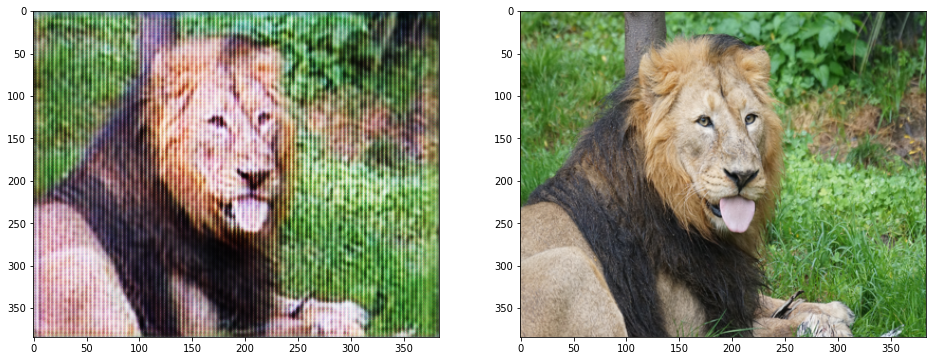

epoch: 2101, [Discriminator :: d_loss: 0.031752], [ Generator :: loss: 0.025460]
epoch: 2102, [Discriminator :: d_loss: 0.478756], [ Generator :: loss: 0.033360]
epoch: 2103, [Discriminator :: d_loss: 1.311528], [ Generator :: loss: 0.025308]
epoch: 2104, [Discriminator :: d_loss: 1.231074], [ Generator :: loss: 0.033003]
epoch: 2105, [Discriminator :: d_loss: 0.224140], [ Generator :: loss: 0.030331]
epoch: 2106, [Discriminator :: d_loss: 0.354651], [ Generator :: loss: 0.040191]
epoch: 2107, [Discriminator :: d_loss: 0.417550], [ Generator :: loss: 0.027868]
epoch: 2108, [Discriminator :: d_loss: 0.076277], [ Generator :: loss: 0.042233]
epoch: 2109, [Discriminator :: d_loss: 0.508453], [ Generator :: loss: 0.029354]
epoch: 2110, [Discriminator :: d_loss: 1.454676], [ Generator :: loss: 0.044938]
epoch: 2111, [Discriminator :: d_loss: 0.399190], [ Generator :: loss: 0.041297]
epoch: 2112, [Discriminator :: d_loss: 0.451980], [ Generator :: loss: 0.033500]
epoch: 2113, [Discriminator 

<Figure size 432x288 with 0 Axes>

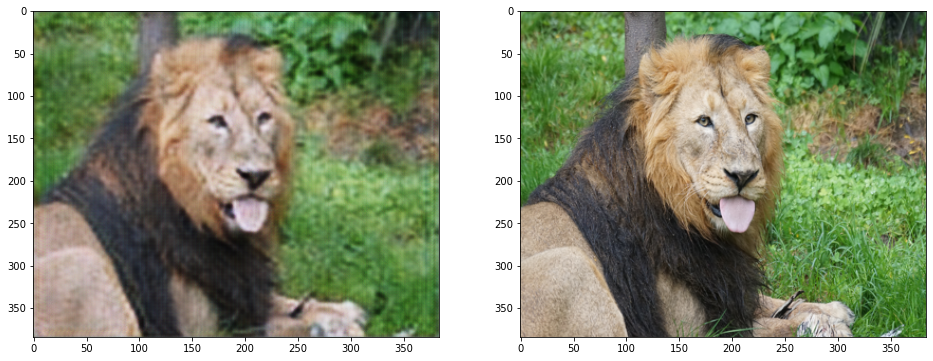

epoch: 2401, [Discriminator :: d_loss: 0.000342], [ Generator :: loss: 0.039898]
epoch: 2402, [Discriminator :: d_loss: 0.001219], [ Generator :: loss: 0.049401]
epoch: 2403, [Discriminator :: d_loss: 0.000208], [ Generator :: loss: 0.047205]
epoch: 2404, [Discriminator :: d_loss: 0.000654], [ Generator :: loss: 0.045297]
epoch: 2405, [Discriminator :: d_loss: 0.001126], [ Generator :: loss: 0.048060]
epoch: 2406, [Discriminator :: d_loss: 0.000112], [ Generator :: loss: 0.049875]
epoch: 2407, [Discriminator :: d_loss: 0.000133], [ Generator :: loss: 0.116564]
epoch: 2408, [Discriminator :: d_loss: 0.001507], [ Generator :: loss: 0.039053]
epoch: 2409, [Discriminator :: d_loss: 0.000637], [ Generator :: loss: 0.042540]
epoch: 2410, [Discriminator :: d_loss: 0.000271], [ Generator :: loss: 0.038913]
epoch: 2411, [Discriminator :: d_loss: 0.000341], [ Generator :: loss: 0.041892]
epoch: 2412, [Discriminator :: d_loss: 0.000294], [ Generator :: loss: 0.038081]
epoch: 2413, [Discriminator 

<Figure size 432x288 with 0 Axes>

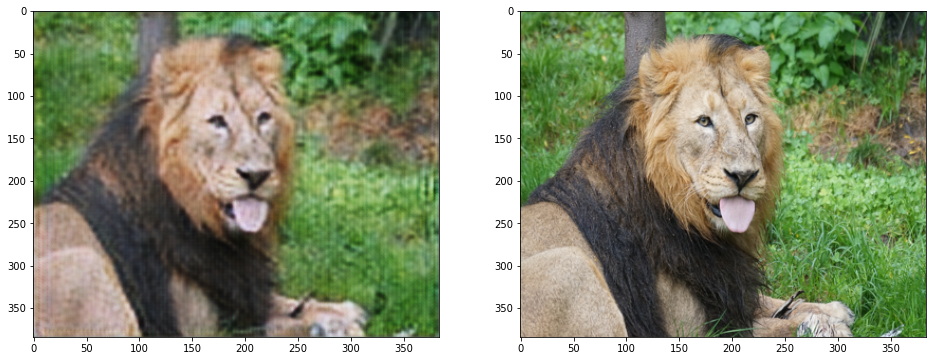

epoch: 2701, [Discriminator :: d_loss: 0.001429], [ Generator :: loss: 0.049163]
epoch: 2702, [Discriminator :: d_loss: 0.000283], [ Generator :: loss: 0.044982]
epoch: 2703, [Discriminator :: d_loss: 0.000164], [ Generator :: loss: 0.038321]
epoch: 2704, [Discriminator :: d_loss: 0.000018], [ Generator :: loss: 0.067456]
epoch: 2705, [Discriminator :: d_loss: 0.000035], [ Generator :: loss: 0.037181]
epoch: 2706, [Discriminator :: d_loss: 0.001610], [ Generator :: loss: 0.117084]
epoch: 2707, [Discriminator :: d_loss: 0.000671], [ Generator :: loss: 0.042410]
epoch: 2708, [Discriminator :: d_loss: 0.000060], [ Generator :: loss: 0.043028]
epoch: 2709, [Discriminator :: d_loss: 0.000091], [ Generator :: loss: 0.037223]
epoch: 2710, [Discriminator :: d_loss: 0.001688], [ Generator :: loss: 0.053201]
epoch: 2711, [Discriminator :: d_loss: 0.000040], [ Generator :: loss: 0.048363]
epoch: 2712, [Discriminator :: d_loss: 0.001405], [ Generator :: loss: 0.040340]
epoch: 2713, [Discriminator 

<Figure size 432x288 with 0 Axes>

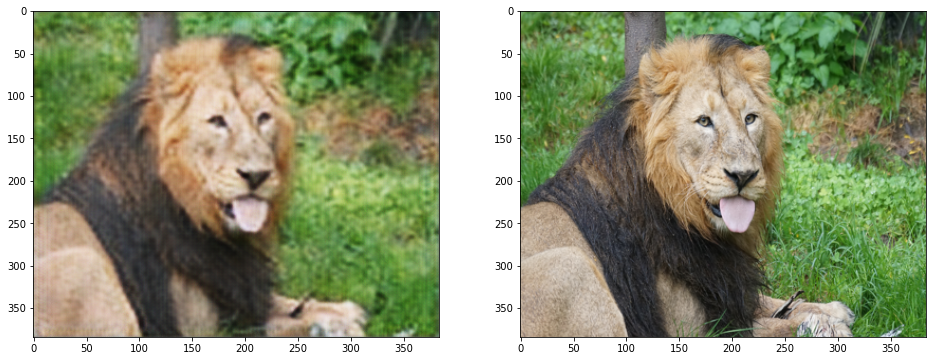

epoch: 3001, [Discriminator :: d_loss: 0.000009], [ Generator :: loss: 0.068958]
epoch: 3002, [Discriminator :: d_loss: 0.000017], [ Generator :: loss: 0.037002]
epoch: 3003, [Discriminator :: d_loss: 0.000035], [ Generator :: loss: 0.118757]
epoch: 3004, [Discriminator :: d_loss: 0.000011], [ Generator :: loss: 0.044075]
epoch: 3005, [Discriminator :: d_loss: 0.000066], [ Generator :: loss: 0.034172]
epoch: 3006, [Discriminator :: d_loss: 0.000012], [ Generator :: loss: 0.066550]
epoch: 3007, [Discriminator :: d_loss: 0.000183], [ Generator :: loss: 0.038434]
epoch: 3008, [Discriminator :: d_loss: 0.000080], [ Generator :: loss: 0.039560]
epoch: 3009, [Discriminator :: d_loss: 0.000098], [ Generator :: loss: 0.040188]
epoch: 3010, [Discriminator :: d_loss: 0.000113], [ Generator :: loss: 0.044959]
epoch: 3011, [Discriminator :: d_loss: 0.000006], [ Generator :: loss: 0.048800]
epoch: 3012, [Discriminator :: d_loss: 0.000140], [ Generator :: loss: 0.038748]
epoch: 3013, [Discriminator 

<Figure size 432x288 with 0 Axes>

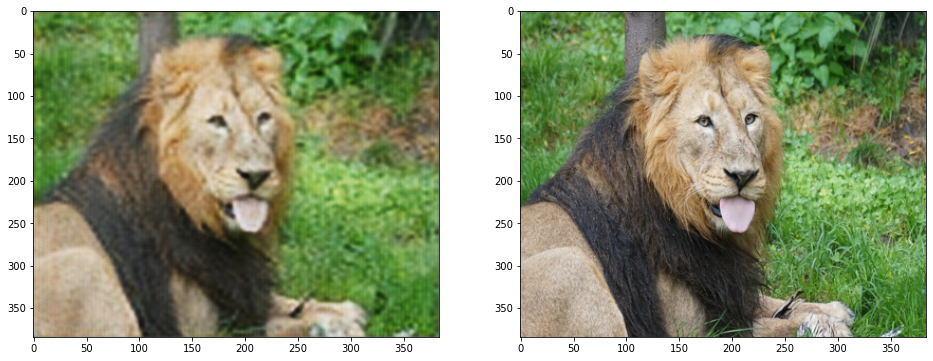

epoch: 3301, [Discriminator :: d_loss: 0.000085], [ Generator :: loss: 0.044719]
epoch: 3302, [Discriminator :: d_loss: 0.000043], [ Generator :: loss: 0.038122]
epoch: 3303, [Discriminator :: d_loss: 0.000034], [ Generator :: loss: 0.039935]
epoch: 3304, [Discriminator :: d_loss: 0.000122], [ Generator :: loss: 0.046620]
epoch: 3305, [Discriminator :: d_loss: 0.000061], [ Generator :: loss: 0.041532]
epoch: 3306, [Discriminator :: d_loss: 0.000029], [ Generator :: loss: 0.037558]
epoch: 3307, [Discriminator :: d_loss: 0.000055], [ Generator :: loss: 0.039287]
epoch: 3308, [Discriminator :: d_loss: 0.000082], [ Generator :: loss: 0.043830]
epoch: 3309, [Discriminator :: d_loss: 0.000008], [ Generator :: loss: 0.039517]
epoch: 3310, [Discriminator :: d_loss: 0.000187], [ Generator :: loss: 0.045295]
epoch: 3311, [Discriminator :: d_loss: 0.000044], [ Generator :: loss: 0.040146]
epoch: 3312, [Discriminator :: d_loss: 0.000096], [ Generator :: loss: 0.044458]
epoch: 3313, [Discriminator 

<Figure size 432x288 with 0 Axes>

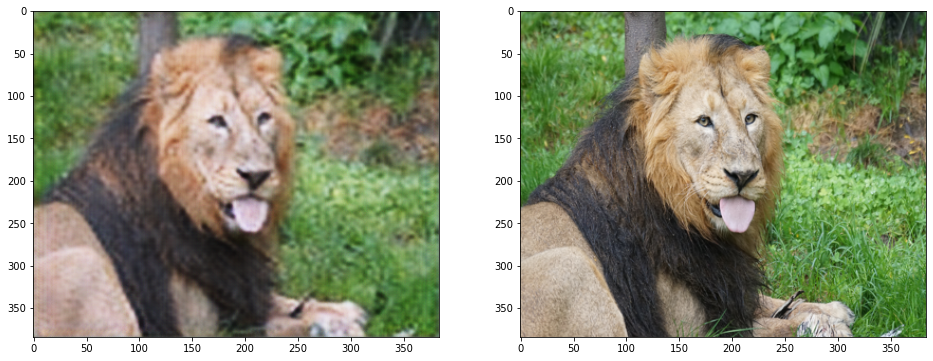

epoch: 3601, [Discriminator :: d_loss: 0.000023], [ Generator :: loss: 0.041525]
epoch: 3602, [Discriminator :: d_loss: 0.000014], [ Generator :: loss: 0.036995]
epoch: 3603, [Discriminator :: d_loss: 0.000020], [ Generator :: loss: 0.117013]
epoch: 3604, [Discriminator :: d_loss: 0.000017], [ Generator :: loss: 0.038452]
epoch: 3605, [Discriminator :: d_loss: 0.000008], [ Generator :: loss: 0.036768]
epoch: 3606, [Discriminator :: d_loss: 0.000034], [ Generator :: loss: 0.044459]
epoch: 3607, [Discriminator :: d_loss: 0.000023], [ Generator :: loss: 0.041365]
epoch: 3608, [Discriminator :: d_loss: 0.000005], [ Generator :: loss: 0.033992]
epoch: 3609, [Discriminator :: d_loss: 0.000035], [ Generator :: loss: 0.038178]
epoch: 3610, [Discriminator :: d_loss: 0.000033], [ Generator :: loss: 0.039971]
epoch: 3611, [Discriminator :: d_loss: 0.000019], [ Generator :: loss: 0.038327]
epoch: 3612, [Discriminator :: d_loss: 0.000029], [ Generator :: loss: 0.042198]
epoch: 3613, [Discriminator 

<Figure size 432x288 with 0 Axes>

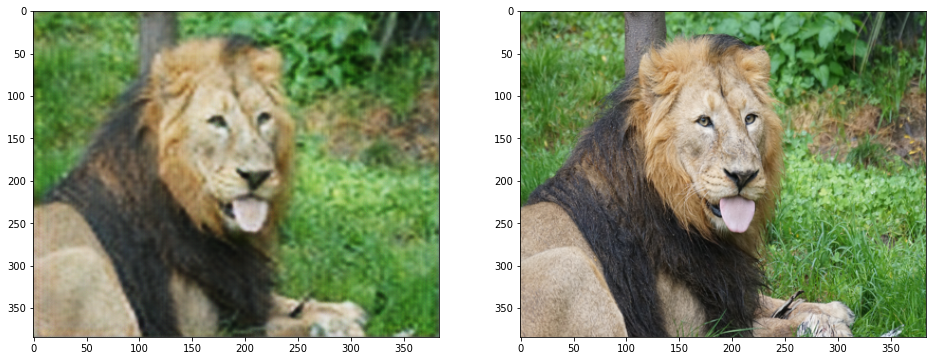

epoch: 3901, [Discriminator :: d_loss: 0.000006], [ Generator :: loss: 0.039277]
epoch: 3902, [Discriminator :: d_loss: 0.000038], [ Generator :: loss: 0.043667]
epoch: 3903, [Discriminator :: d_loss: 0.000009], [ Generator :: loss: 0.038082]
epoch: 3904, [Discriminator :: d_loss: 0.000051], [ Generator :: loss: 0.041500]
epoch: 3905, [Discriminator :: d_loss: 0.000008], [ Generator :: loss: 0.066024]
epoch: 3906, [Discriminator :: d_loss: 0.000067], [ Generator :: loss: 0.047650]
epoch: 3907, [Discriminator :: d_loss: 0.000030], [ Generator :: loss: 0.038128]
epoch: 3908, [Discriminator :: d_loss: 0.000009], [ Generator :: loss: 0.038067]
epoch: 3909, [Discriminator :: d_loss: 0.000029], [ Generator :: loss: 0.039244]
epoch: 3910, [Discriminator :: d_loss: 0.000067], [ Generator :: loss: 0.038335]
epoch: 3911, [Discriminator :: d_loss: 0.000013], [ Generator :: loss: 0.042993]
epoch: 3912, [Discriminator :: d_loss: 0.000013], [ Generator :: loss: 0.049604]
epoch: 3913, [Discriminator 

<Figure size 432x288 with 0 Axes>

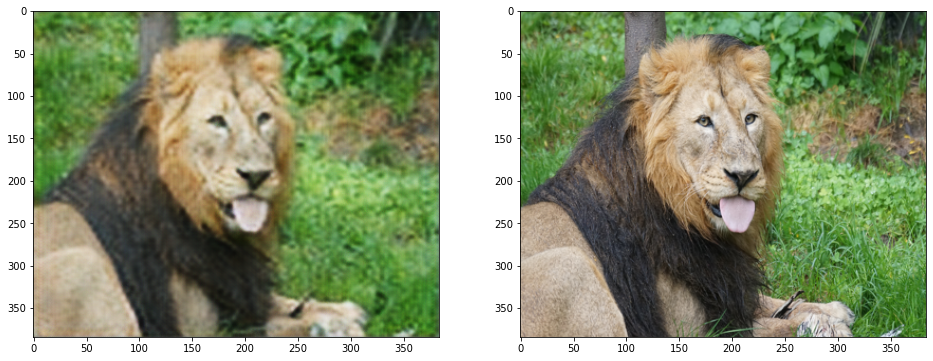

In [15]:
DD_loss, GG_loss = modelo2.train_transfer(epochs=4201, path='training_modelo2_version2', save_interval=300)


Let's see the original LR image, the generated after 4500 epochs and the HR one:

<Figure size 432x288 with 0 Axes>

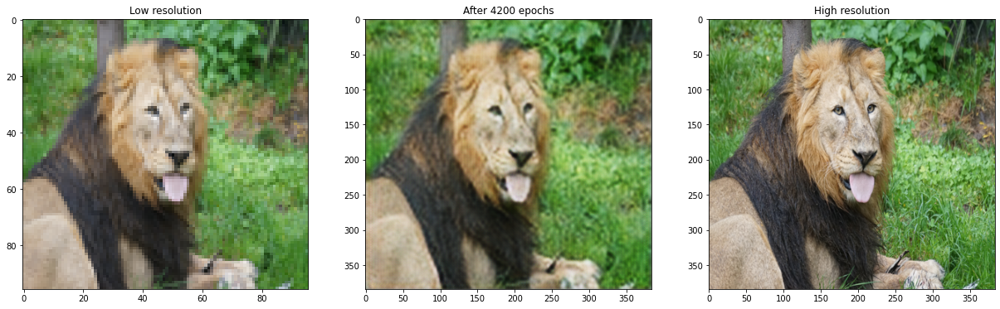

In [16]:
pred = modelo2.G.predict(LR_train)

plt.figure()  
f, ax= plt.subplots(1,3, figsize=(21, 6))
ax[0].imshow(LR_train[8], aspect='auto')
ax[0].set_title('Low resolution')
ax[1].imshow(pred[8], aspect='auto')
ax[1].set_title('After 4200 epochs')
ax[2].imshow(HR_train[8], aspect='auto')
ax[2].set_title('High resolution');

Let's see the train predictions:

In [23]:
inter_models = range(0,4201,300)
modelsG, modelsD = cargar_modelos(entrenamiento_a_cargar='training_modelo2_version2', form='weights')
predicciones_train_model2 = predecir_dict(iter=inter_models, modelsG=modelsG, LR_train=LR_train)

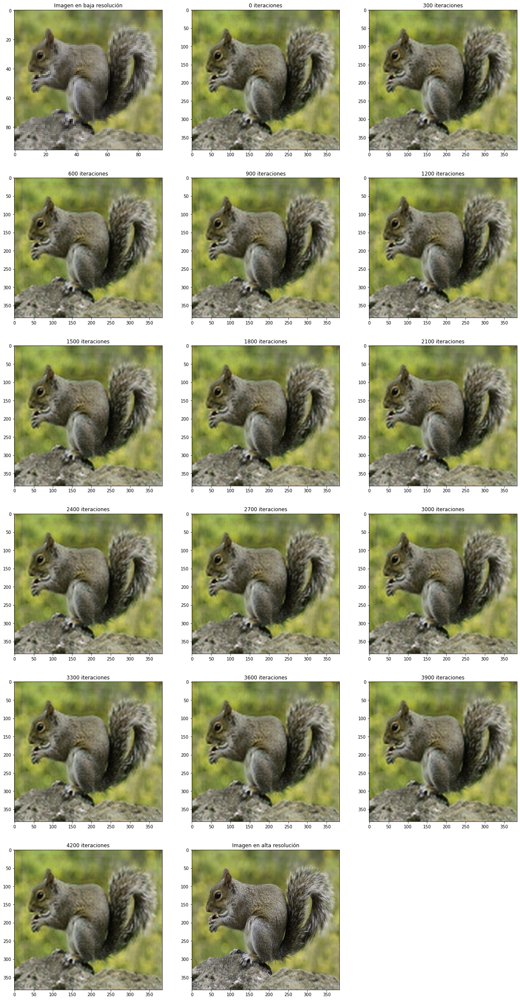

In [24]:
plot_results(predicciones_train_model2, img=9, HR=HR_train, LR=LR_train)

### Test

Now let's see the test results:

In [25]:
predicciones_test_model2 = predecir_dict(iter=inter_models, modelsG=modelsG, LR_train=LR_test)

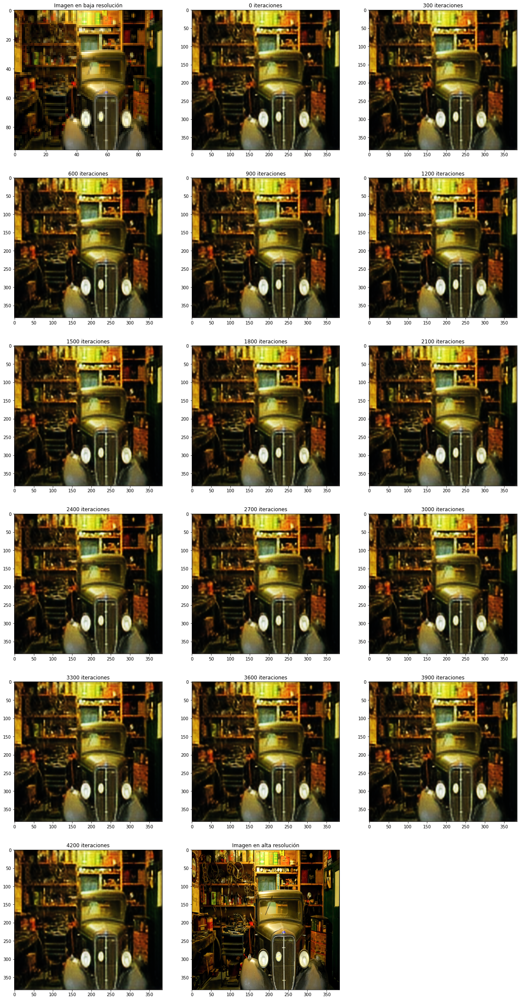

In [ ]:
plot_results(predicciones_test_model2, img=9, HR=HR_test, LR=LR_test)

## Result comparison

Let's see the original LR image, the generated after 4500 epochs with each of the models and the HR one.

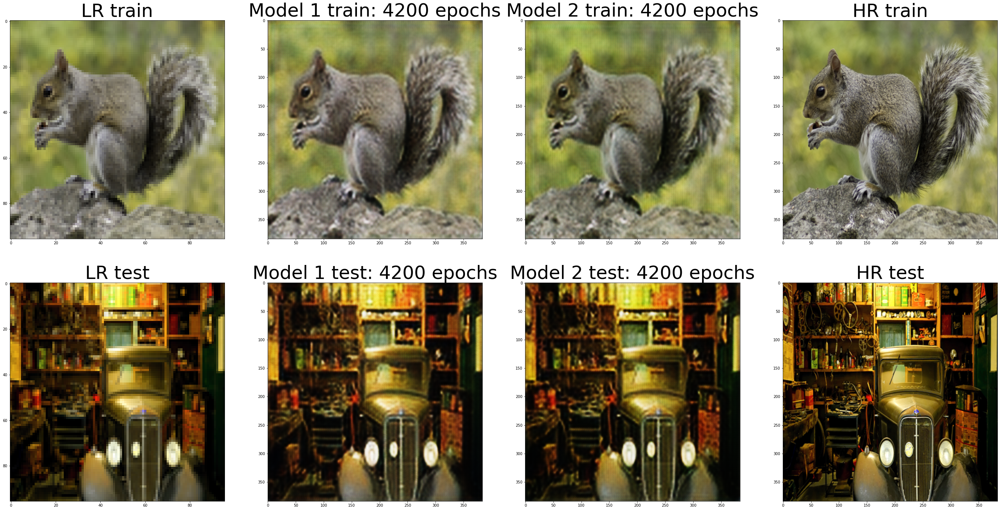

In [27]:
img = 9
f = 50
fig = plt.figure(figsize=(48,24))
# train image
ax = fig.add_subplot(241)
ax.imshow(LR_train[img], aspect='auto')
ax.set_title('LR train', fontsize=f)
ax = fig.add_subplot(242)
ax.imshow(predicciones_train_model1['4200'][img], aspect='auto')
ax.set_title('Model 1 train: 4200 epochs', fontsize=f)
ax = fig.add_subplot(243)
ax.imshow(predicciones_train_model2['4200'][img], aspect='auto')
ax.set_title('Model 2 train: 4200 epochs', fontsize=f)
ax = fig.add_subplot(244)
ax.imshow(HR_train[img], aspect='auto')
ax.set_title('HR train', fontsize=f)
# test image
ax = fig.add_subplot(245)
ax.imshow(LR_test[img], aspect='auto')
ax.set_title('LR test', fontsize=f)
ax = fig.add_subplot(246)
ax.set_title('Model 1 test: 4200 epochs', fontsize=f)
ax.imshow(predicciones_test_model1['4200'][img], aspect='auto')
ax = fig.add_subplot(247)
ax.set_title('Model 2 test: 4200 epochs', fontsize=f)
ax.imshow(predicciones_test_model2['4200'][img], aspect='auto')
ax = fig.add_subplot(248)
ax.imshow(HR_test[img], aspect='auto')
ax.set_title('HR test', fontsize=f);

## Conclusions

We have managed to smooth the 96x96 pixel images remarkably well by increasing their resolution by 4. The execution times are slightly long and the results are not at the state-of-art of computer vision. It should be noted that we found no apparent difference between the images proposed in both models. However, the objective of the project has been achieved as we managed to improve the resolution a bit.

As possible improvements, it is suggested to redefine the models and try other training formulas, since perhaps more convenient possibilities for this problem, as well as train the models with more iterations.

### Bibliography
* Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial
Network. Christian Ledig, Lucas Theis et al. 2017. https://arxiv.org/abs/1609.04802 

* Kaggle dataset. https://www.kaggle.com/datasets/akhileshdkapse/super-image-resolution


* Guías de transfer learning para la extracción de características. https://machinelearningmastery.com/how-to-use-transfer-learning-when-developing-convolutional-neural-network-models/. 
 https://keras.io/guides/transfer_learning/

* Lista de modelos ya entrenados disponibles en Keras. https://keras.io/api/applications/